In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import re
from tqdm import tqdm
import numpy as np
import pickle
import pandas as pd
import pymc3 as pm
import datetime
import pytz
from theano import shared
import theano.tensor as tt
import theano
from pymc3.distributions.dist_math import binomln, betaln, bound
np.set_printoptions(suppress=True)

/home/ubuntu/miniconda3/lib/python3.6/site-packages/theano/gpuarray/dnn.py:184: UserWarning: Your cuDNN version is more recent than Theano. If you encounter problems, try updating Theano or downgrading cuDNN to a version >= v5 and <= v7.
  warnings.warn("Your cuDNN version is more recent than "
Using cuDNN version 8004 on context None
Mapped name None to device cuda1: A100-SXM4-40GB (0000:41:00.0)


In [3]:
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('png', 'pdf')

In [4]:
# Helper function for visualization
def plot_traces(trcs, varnames=None):
    '''Plot traces with overlaid means and values'''

    nrows = len(trcs.varnames)
    if varnames is not None:
        nrows = len(varnames)

    ax = pm.traceplot(trcs, varnames=varnames, figsize=(12,nrows*1.4),
                      lines={k: v['mean'] for k, v in
                             pm.summary(trcs,varnames=varnames).iterrows()})

    for i, mn in enumerate(pm.summary(trcs, varnames=varnames)['mean']):
        ax[i,0].annotate('{:.2f}'.format(mn), xy=(mn,0), xycoords='data',
                         xytext=(5,10), textcoords='offset points', rotation=90,
                         va='bottom', fontsize='large', color='#AA0022')
def strip_derived_rvs(rvs):
    '''Remove PyMC3-generated RVs from a list'''

    ret_rvs = []
    for rv in rvs:
        if not (re.search('_log',rv.name) or re.search('_interval',rv.name)):
            ret_rvs.append(rv)
    return ret_rvs

In [5]:
# Load the data and process it.

df = pd.read_csv("mturk_surveys_extended.csv", low_memory=False)
df["hit_answered_date"]=pd.to_datetime(df["hit_answered_date"])
#df = df[(df['hit_answered_date']<datetime.datetime(2023, 5, 1,tzinfo=pytz.UTC))]
df['date'] = pd.to_datetime(df['hit_answered_date'].apply(lambda x : x.date()))

# Calculate the time period of each survey answer. 
# Below we take out time period to be 30-day periods. 
# We can change this to be weeks, months, or anything else
window_length = 30
minDate = min(df['date'])
df['period'] = (df['date'] - minDate).dt.days // window_length 

#df = df[(df['period'] < df.period.max())]

# Create a list of all unique worker IDs 
workers = pd.DataFrame(list(set(df.worker_id)), columns=['worker_id']).reset_index().set_index('worker_id')

# The data has a full missing period (57. We remove it.
df.loc[df['period'] >57, "period"] = df['period'] -1

# Fix the issue of duplicate records within the same period.
data = df[['worker_id', 'period']].drop_duplicates().pivot_table(
    index = 'worker_id',
    values = 'period',                    
    aggfunc=('count','min','max')
).join(workers).set_index('index').sort_index()

# Aggregate the capture histories
data = data.groupby(['min', 'max', 'count']).size().reset_index(name='count_history')

<AxesSubplot:>

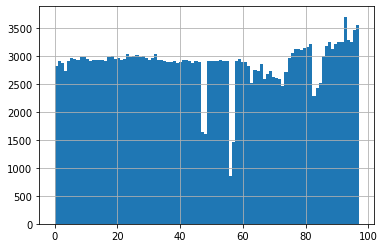

In [6]:
df.period.hist(bins = len(df.period.unique()))


In [7]:
# Summary of input

S = df['period'].max() + 1
V = len(workers)
freqs = data['count_history'].values
H = len(freqs)

print('Sampling periods:', S)
print('Unique patterns:', H)
print('Unique workers:', V)
print(min(df['date']), max(df['date']))

Sampling periods: 98
Unique patterns: 14811
Unique workers: 121723
2015-03-26 00:00:00 2023-05-12 00:00:00


In [8]:
len(df[['worker_id', 'period']].drop_duplicates())

267832

In [9]:
# We want to see the survival marks to compute the total survival
# e.g, Arrive: 1, Depart: 2 => 011
# Dims: SxSxS
def make_survival(S):
    mask = np.zeros([S,S,S])  # arrival, departure, presence_sequence
    for s in np.arange(S):
        for q in np.arange(s,S):
            c1 = np.zeros(s)
            c2 = np.ones(q-s)
            c3 = np.zeros(S-q)
            mask[s,q]= np.concatenate((c1, c2, c3))
    return mask
survival = tt.constant(make_survival(S))

In [10]:
# A more compact way to represent all Arrival and departures from the data
# This is part of the input data, so we preprocess it!
def get_hmask(S, H, data):
    h_mask = np.zeros((H,S,S))
    for wh in np.arange(H):
        f, l = data['min'].values[wh] , data['max'].values[wh]
        h_mask[wh, :f+1, l:] = 1
    return h_mask
hmask = tt.constant(get_hmask(S, H, data))
hmask.shape

Shape.0

In [11]:
# For a given outcome in {1,S} (Frequency of capture that's not 0) 
# Generate the Binomial parameters n and i   choose(n, i)
# Nn is the duration from arrival to departure
# Ni is the Frequency we are intersted in
# Dim: SxSxS
def make_binmask(S, data):
    i = data['count'].values
    i = i[:, np.newaxis, np.newaxis] *  np.ones((H, S, S))
    n = np.broadcast_to(np.triu(np.ones([S,S]), 0).cumsum(axis =1), (H, S, S))
    return tt.constant(i), tt.constant(n)
Ni, Nn = make_binmask(S, data)
print('Tensor with number of captures', Ni.shape)
print('Tensor with durations from first to last seen', Nn.shape)

Tensor with number of captures Shape.0
Tensor with durations from first to last seen Shape.0


In [12]:
# Helper functions for the Beta Bernoulli Process
# TODO: switch to a single function even for the special case of 0 captures.

def get_BetaBi(a,b, S, Ni, Nn):
    # The beta binomial
    BBi  =  bound(betaln(Ni + a, Nn - Ni + b) - betaln(a, b),
                     Ni >= 0, Ni <= Nn,
                     a > 0, b > 0)
    # The above is the computation of the log, so we take the exponent
    return tt.exp(BBi)

def get_BetaB0(a, b, S):
    # The beta binomial for 0 captures
    Nn = tt.triu(tt.ones([S,S]), 0).cumsum(axis =1).eval()
    #B0 = tt.gammaln(n + b) - tt.gammaln(n + a + b) + tt.gammaln(a + b) - tt.gammaln(b)
    B0 = bound(betaln(a, Nn + b) - betaln(a, b), 
               a > 0, b > 0)
    return tt.exp(B0)

In [13]:
def logp_capture(arrival_probs, departure_probs, a, b, U, survival_mask, Ni, Nn, S, V):
    def ll_capture_f(Nh, data_first_last_mask):
          
        # Likelihood of observing Li captures
        
        # compute the survival
        survival_prob = tt.pow(1 - departure_probs, survival_mask)
        survival_prob = tt.prod(survival_prob, axis=2)
        # compute the arrival and departure
        LAD      = arrival_probs[:, np.newaxis] * survival_prob * departure_probs    # SxS
        # keep only true possibilites
        True_LAD = LAD * data_first_last_mask # SxSxS
        
        # sum along the freqencies of catpures
        BetaBi  = get_BetaBi(a, b, S, Ni, Nn)
        Li      = tt.batched_tensordot(True_LAD, BetaBi, axes = 2) # S
        
        # Likelihood of No-Capture L0
        
        True_LAD0    = LAD * tt.triu(tt.ones((S,S)), 0)
        BetaB0   = get_BetaB0(a, b, S)
        L0       = tt.sum(True_LAD0 * BetaB0)
        
        # Multinomial
        obj1 = tt.gammaln(V + U + 1) - tt.gammaln(U + 1) - tt.sum(tt.gammaln(Nh+1))
        obj2 = tt.sum(Nh * tt.log(Li))
        obj3 = U * tt.log(L0)
        
        objective = obj1 + obj2 + obj3 
        
        return objective
    
    return ll_capture_f

In [14]:
# custom log-liklihood
# model

with pm.Model() as model:
    # parameters
    U = pm.Uniform('Unseen', lower=1, upper=500000)
    #ao = pm.Uniform('alpha-', 0., 100)
    a = 1.
    b = pm.Uniform('beta', 0., 100)
    
    phi = tt.zeros(S)
    phi_v = pm.Uniform('departure', 0, 0.5, shape=S-1)
    phi = tt.set_subtensor(phi[S-1], 1.)
    phi = tt.set_subtensor(phi[:S-1],phi_v)
    
    arr    = pm.Dirichlet('arrival', a=np.concatenate(([.8], np.array([.2/(S-1)]*(S-1))), axis=0), shape=S)
    #U_print = tt.printing.Print('Unseen')(U)
    #a_print = tt.printing.Print('alpha')(a)
    #b_print = tt.printing.Print('beta')(b)
    # Model Log-likelihood
    ob = pm.DensityDist('x', logp_capture(arr, phi, a, b, U, survival, Ni, Nn, S, V), 
                        observed={'Nh': freqs ,
                                  'data_first_last_mask': hmask })

In [15]:
with model:
    fit = pm.fit(n=100000, method='advi', model=model, obj_optimizer=pm.adagrad_window(learning_rate=1e-4))

Average Loss = 2.5355e+05: 100%|██████████| 100000/100000 [1:21:39<00:00, 20.41it/s]
Finished [100%]: Average Loss = 2.5355e+05


In [24]:
trace_vi = fit.sample(10000)

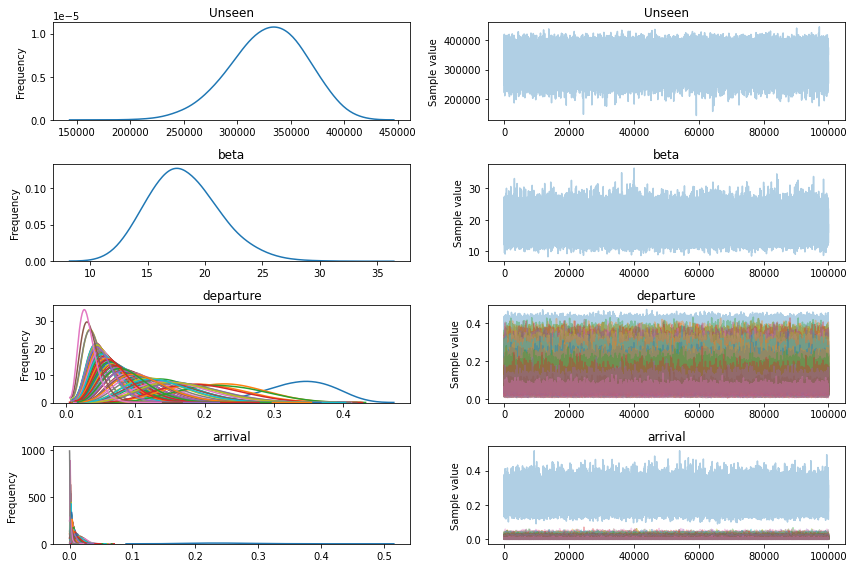

In [26]:
pm.traceplot(trace_vi);

In [56]:
with model:
    advi = pm.ADVI()

In [57]:
tracker = pm.callbacks.Tracker(
    mean=advi.approx.mean.eval,  # callable that returns mean
    std=advi.approx.std.eval,  # callable that returns std
)
approx = advi.fit(100000, callbacks=[tracker], obj_optimizer=pm.adagrad_window(learning_rate=1e-4))

Average Loss = 2.5358e+05: 100%|██████████| 100000/100000 [1:21:52<00:00, 20.36it/s]
Finished [100%]: Average Loss = 2.5358e+05


No handles with labels found to put in legend.


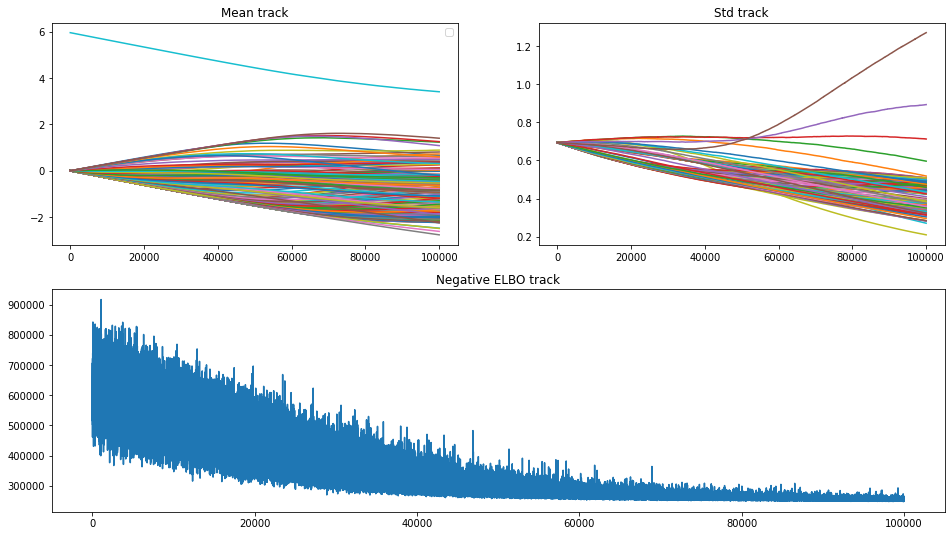

In [58]:
fig = plt.figure(figsize=(16, 9))
mu_ax = fig.add_subplot(221)
std_ax = fig.add_subplot(222)
hist_ax = fig.add_subplot(212)
mu_ax.plot(tracker["mean"])
mu_ax.legend()
mu_ax.set_title("Mean track")
std_ax.plot(tracker["std"])
std_ax.set_title("Std track")
hist_ax.plot(advi.hist)
hist_ax.set_title("Negative ELBO track");

In [157]:
vtrace = approx.sample(50000)

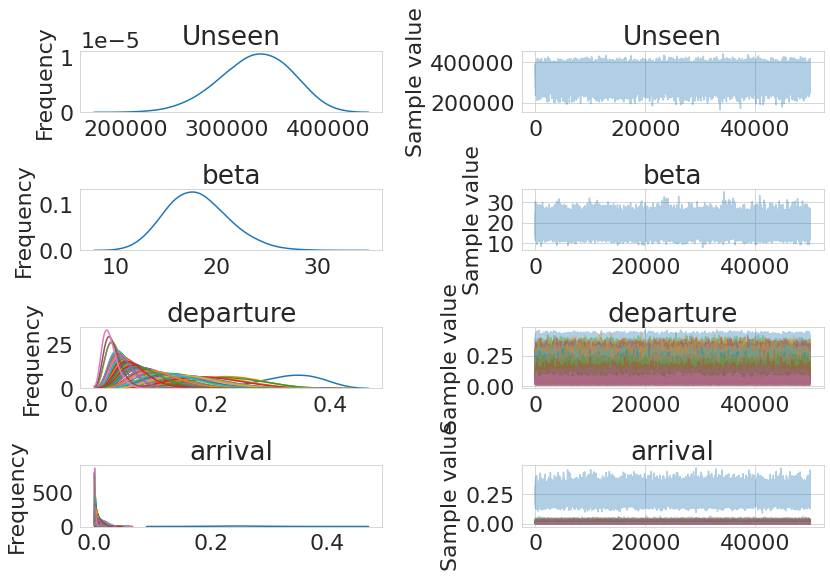

In [158]:
pm.traceplot(vtrace);

In [188]:
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

from IPython.display import set_matplotlib_formats
set_matplotlib_formats('png', 'pdf')

mpl.rc("figure", figsize=(16, 8))
mpl.rcParams.update({'font.size': 22})
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42
sns.set_style("whitegrid")

<module 'seaborn' from '/home/ubuntu/miniconda3/lib/python3.6/site-packages/seaborn/__init__.py'>

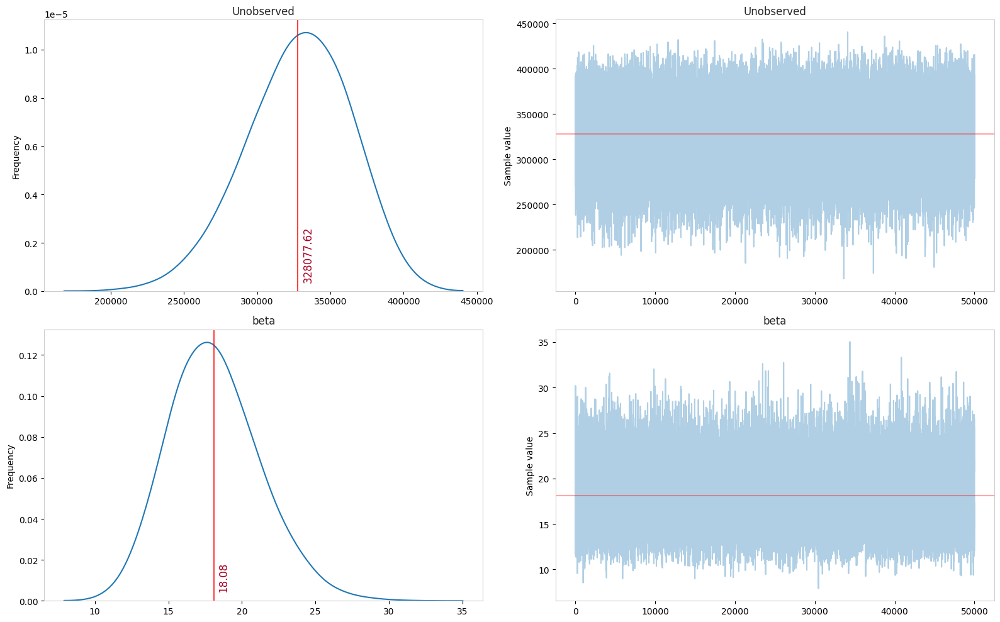

In [189]:
ax = pm.traceplot(vtrace, varnames=['Unseen', 'beta'], figsize=(16, 2*5),
                  lines={k: v['mean'] for k, v in
                         pm.summary(trace_vi,varnames=['Unseen', 'beta']).iterrows()})

for i, mn in enumerate(pm.summary(vtrace, varnames=['Unseen', 'beta'])['mean']):
    ax[i,0].annotate('{:.2f}'.format(mn), xy=(mn,0), xycoords='data',
                     xytext=(5,10), textcoords='offset points', rotation=90,
                     va='bottom', fontsize='large', color='#AA0022')

for i in range(2):
    ax[0, i].set_title('Unobserved')
    
fig = plt.gcf()
fig.savefig('parameters.pdf', bbox_inches='tight')

In [190]:
pm.summary(vtrace, varnames=['Unseen', 'beta'])

,mean,sd,mc_error,hpd_2.5,hpd_97.5
Unseen,328077.625000,35805.386719,152.149805,256043.828125,394197.687500
beta,18.083563,3.101844,0.013705,12.278180,24.275736


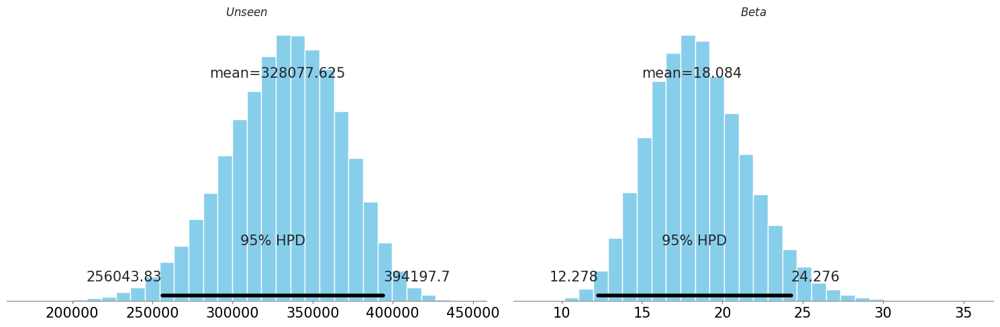

In [275]:
ax = pm.plot_posterior(vtrace, varnames=['Unseen', 'beta'], figsize=(15,5), color='#87ceeb', point_estimate='mean')
ax[0].set_title('$Unseen$')
ax[1].set_title('$Beta$');

In [197]:
print(pm.summary(vtrace).head(2))


                 mean            sd    mc_error        hpd_2.5       hpd_97.5
Unseen  328077.625000  35805.386719  152.149805  256043.828125  394197.687500
beta        18.083563      3.101844    0.013705      12.278180      24.275736


In [64]:
def MinMaxNorm(data):
    dataf=((data-data.min())/(data.max()-data.min()))
    return dataf

In [65]:
country_table_time = pd.crosstab(index=df.period, 
                                 columns=df.location_country, 
                                 values='worker_id', 
                                 aggfunc=np.count_nonzero, 
                                 normalize='index')

In [205]:
unseen = int(vtrace['Unseen'].mean())
unseen

328077

In [206]:
U = V + unseen  # Super population
print("Super Population: ", U)
arrivs = vtrace['arrival'][-1]* U # Arrivals
deps = vtrace['departure'][-1]* U
deps = np.insert(deps, 0, 0)
noDeps = arrivs.cumsum() 
withDeps = noDeps - deps

Super Population:  449800


In [67]:
arrivs[1:].mean()

3183.2917401533737

In [86]:
arrivs[1:] * country_table_time[1:].drop(['US'], axis=1).sum(axis=1)

period
1     161.938392
2      51.278187
3     201.373486
4     160.047266
5     210.019017
         ...    
93    801.151951
94    217.961299
95    157.458297
96     44.584278
97     20.246354
Length: 97, dtype: float64

In [194]:
arrivs[1:]

449202.0737345335

Text(0.5, 1.0, 'Arrival (New Workers)')

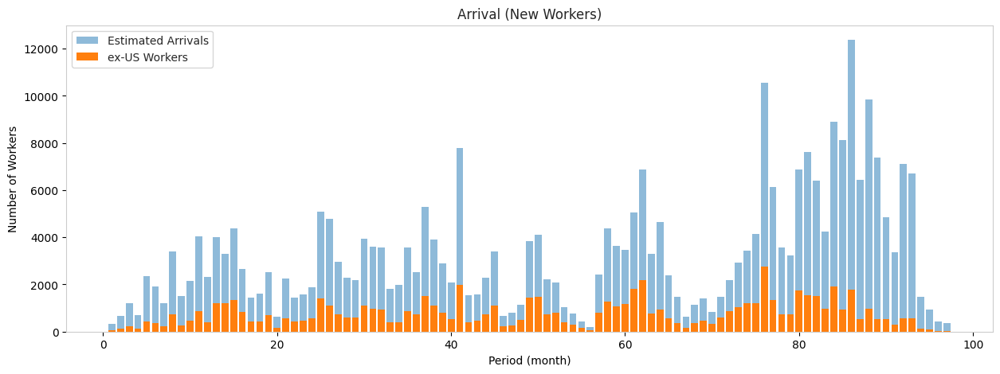

In [276]:
# Percentage of Super-population Arrivals
fig = plt.figure(figsize=(15, 5))
plt.bar(np.arange(S-1)+1, arrivs[1:], alpha=0.5) 
ex_US = arrivs[1:] * country_table_time[1:].drop(['US'], axis=1).sum(axis=1)
plt.bar(np.arange(S-1)+1, ex_US, alpha = 1)
#MinMaxNorm(country_table_time[['US', 'IN']].sum(axis=1)).plot(color = 'Teal')
plt.xlabel('Period (month)')
plt.ylabel('Number of Workers')
plt.legend(['Estimated Arrivals', 'ex-US Workers'])
plt.title('Arrival (New Workers)')
#fig.savefig('arrival.pdf', bbox_inches='tight')

In [ ]:
#non_US_IN[:12].mean()

In [253]:
prev = 0
h = np.zeros(S)
d = np.insert(vtrace['departure'][-1], 0, 0)
for i in np.arange(S):
    #print(">>", prev, d[i], arrivs[i])
    current = prev - (prev * d[i]) + arrivs[i] #reduce previous with departed, add arrival
    #print(current)
    prev = current
    h[i] = (prev * d[i])

In [254]:
h

array([    0.        , 31383.10279997,  9538.56507346, 12201.13578041,
        3900.89061034,  3101.54264204,  4320.33465643,  1127.05394423,
        3009.23820508,  3137.37149444,  1355.89844522,  2091.90273968,
        2876.5300645 ,  2441.43030526,  3388.92626447,  2182.69190822,
        5104.67565369,  1640.39540594,  4132.2172991 ,  3259.3395303 ,
        3469.59900747,  2193.93591709,  3378.76256445,  1146.35963433,
        1250.22961769,  3608.29791019,  1932.65185887,  3338.84921302,
        2336.63208562,  1977.47218929,  2579.37730369,  1624.60757591,
        4584.51102798,  1767.32600555,  1973.27973941,  2563.36305494,
        2924.7264698 ,  3965.16976955,  2812.99718014,  2729.97887487,
        3977.51896898,  5318.02692935,  1871.02753201,  4108.91290822,
        4078.97959665,  2505.00619908,  4441.11393593,  3907.50874777,
        2731.10946597,  1994.87929931,  3326.94335237,  2197.14007116,
        2067.77136554,  1994.05863472,  3211.39260007,  2560.14531077,
      

<function matplotlib.pyplot.show(close=None, block=None)>

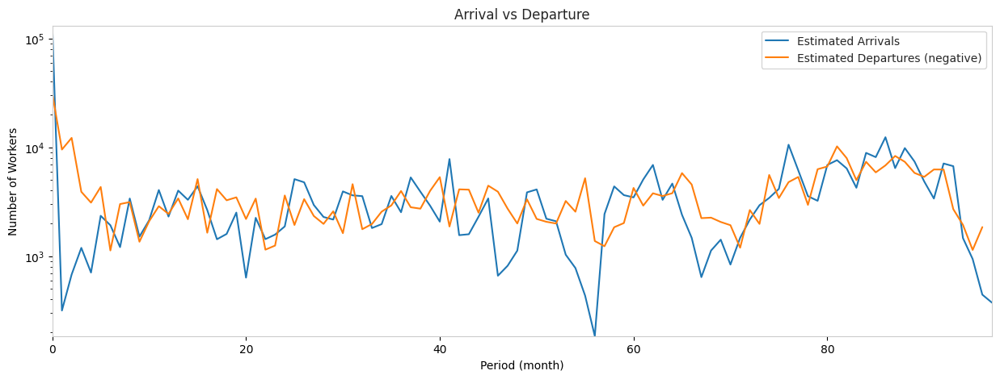

In [272]:
fig = plt.figure(figsize=(15,5))
plt.plot(np.arange(S), arrivs)
plt.plot(np.arange(S-1), h[1:])
plt.xlabel('Period (month)')
plt.ylabel("Number of Workers")
plt.autoscale(tight=True)
plt.legend(['Estimated Arrivals', 'Estimated Departures (negative)'])
fig.savefig('population-dynamics.pdf', bbox_inches='tight')
plt.title('Arrival vs Departure')
plt.yscale('log')
plt.show

In [91]:
country_table_time[['US', 'IN', 'DZ']]

location_country,US,IN,DZ
period,,,
0,0.754336,0.206726,0.0
1,0.803626,0.154294,0.0
2,0.811262,0.149809,0.0
3,0.797228,0.159737,0.0
4,0.800618,0.152711,0.0
...,...,...,...
93,0.918307,0.042329,0.0
94,0.922121,0.037273,0.0
95,0.916054,0.038603,0.0


In [92]:
trace_vi['arrival'][-1][1:].sum()

0.68739516

<AxesSubplot:xlabel='period'>

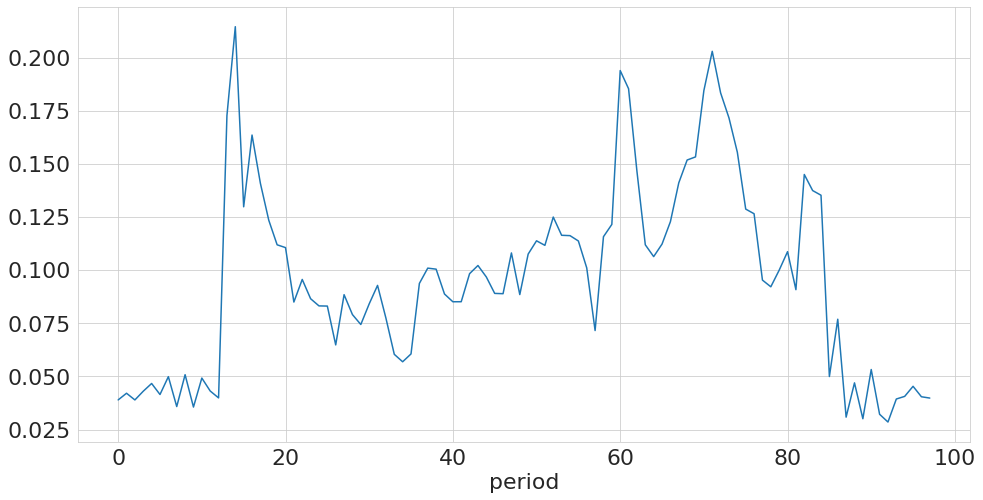

In [93]:
country_table_time.drop(['US','IN'], axis=1).sum(axis = 1).plot()

/home/ubuntu/miniconda3/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/ubuntu/miniconda3/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


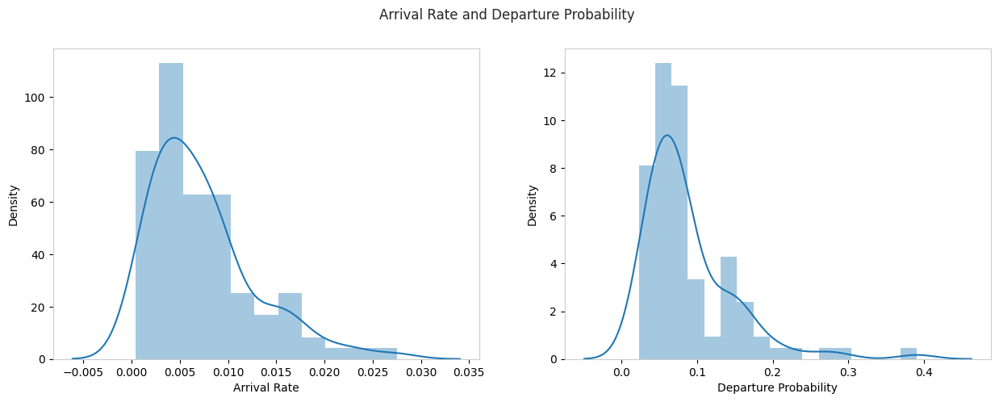

In [278]:
fig = plt.figure(figsize = (15, 5))
fig.add_subplot(1, 2, 1)   #top and bottom left
fig.suptitle("Arrival Rate and Departure Probability")
sns.distplot(vtrace['arrival'][-1][1:])
plt.xlabel("Arrival Rate")
plt.ylabel("Density")
fig.add_subplot(1, 2, 2)   #top right

sns.distplot(vtrace['departure'][-1])
plt.xlabel("Departure Probability")
plt.ylabel("Density")
plt.show()
fig.savefig("parameters.pdf", bbox_inches='tight')